# Projet UBER PICKUPS

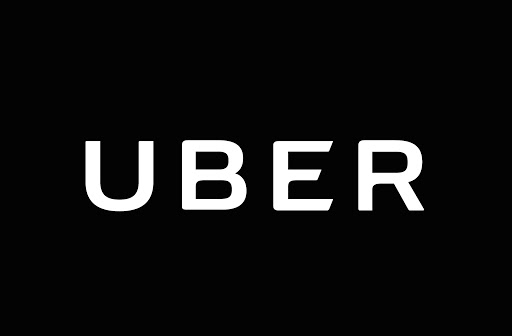






## DESCRIPTION:

##### Dans ce projet, vous allez vous rendre compte du pouvoir des KMeans dans le monde actuel. Imaginez que vous êtes Uber et que vous souhaitez donner des recommendations quant aux endroits où les chauffeurs devraient se trouver pour maximiser leurs chances de trouver une course.


## OBJECTIVE:

#### Nous allons utiliser le Machine Learning pour créer cet algorithme de recommandations.


    Essayez de voir le nombre de clusters optimum
    Trouvez ces clusters sur une map
    Séparez maintenant ces clusters en fonction des périodes de la journée
    Regardez la différence KMeans et DBSCAN

## Analyse des données

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns
import warnings      
warnings.filterwarnings("ignore")

In [2]:
dataset1 = pd.read_csv("taxi-zone-lookup.csv")
dataset2 = pd.read_csv("uber-raw-data-apr14.csv")
# dataset3 = pd.read_csv("uber-raw-data-aug14.csv")
# dataset4 = pd.read_csv("uber-raw-data-janjune-15.csv")
# dataset5 = pd.read_csv("uber-raw-data-jul14.csv")
# dataset6 = pd.read_csv("uber-raw-data-jun14.csv")
# dataset7 = pd.read_csv("uber-raw-data-may14.csv")
# dataset8 = pd.read_csv("uber-raw-data-sep14.csv")
# dataset9 = pd.read_csv()
# dataset = pd.read_csv()

On charge le dataset Uber Pickups du mois d'avrile 2014

In [3]:
dataset1.shape

(265, 3)

In [4]:
dataset1.head()

,LocationID,Borough,Zone
0,1,EWR,Newark Airport
1,2,Queens,Jamaica Bay
2,3,Bronx,Allerton/Pelham Gardens
3,4,Manhattan,Alphabet City
4,5,Staten Island,Arden Heights


In [5]:
dataset2.shape

(564516, 4)

In [6]:
dataset2.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [7]:
dataset2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 564516 entries, 0 to 564515
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date/Time  564516 non-null  object 
 1   Lat        564516 non-null  float64
 2   Lon        564516 non-null  float64
 3   Base       564516 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.2+ MB


In [8]:
dataset2.isna().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

In [9]:
dataset1.isna().sum()

LocationID    0
Borough       0
Zone          0
dtype: int64

In [10]:
dataset2.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [11]:
# from geopy.geocoders import Nominatim

In [12]:
##TEST##

# from geopy.geocoders import Nominatim

# geolocator = Nominatim(user_agent="yet_another_app")
# location = geolocator.reverse("40.7267,-74.0345")
# loc_dict = dict(location.raw)
# loc_dict["address"]

In [13]:
# from time import sleep
# dataset2["zone"] = 0
# for i in range(0, len(dataset1)):
#   geolocator = Nominatim(user_agent="yet_another_app_2")
#   location = geolocator.reverse("{}, {}".format(dataset2.loc[i, "Lat"], dataset2.loc[i, "Lon"]), timeout = None)
#   loc_dict = dict(location.raw)
#   #print(dict(location.raw)["address"])

#   try:
#     dataset2.loc[i, "zone"] = loc_dict["address"]["suburb"]
#   except:
#     pass

In [14]:
dataset2

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
...,...,...,...,...
564511,4/30/2014 23:22:00,40.7640,-73.9744,B02764
564512,4/30/2014 23:26:00,40.7629,-73.9672,B02764
564513,4/30/2014 23:31:00,40.7443,-73.9889,B02764
564514,4/30/2014 23:32:00,40.6756,-73.9405,B02764


### Les clusters :

#### Avril 2014

In [15]:
dataset2_geo=dataset2.drop(["Date/Time","Base"],axis=1)

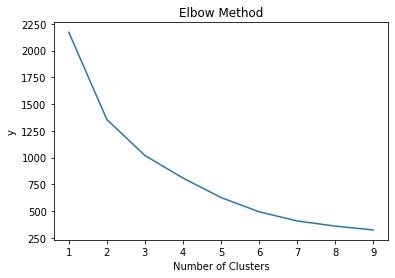

In [16]:
from sklearn.cluster import KMeans
y=[]
for i in range (1,10): 
    kmeans = KMeans(n_clusters= i, init = "k-means++", max_iter = 300, n_init = 10, random_state = 0)
    kmeans.fit(dataset2_geo)
    y.append(kmeans.inertia_)

plt.plot(range(1,10), y)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('y')
plt.show()

In [17]:
!pip install yellowbrick


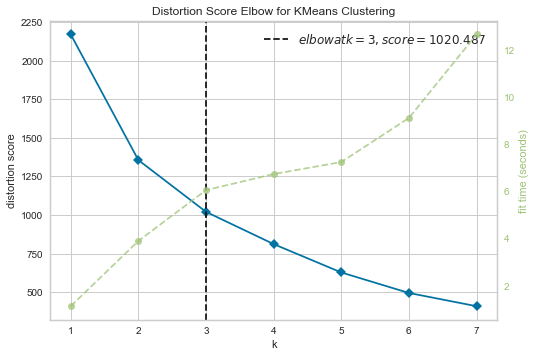

In [18]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,8))
visualizer.fit(dataset2_geo)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render th

  ##### Avec la méthode Elbow. On observe sur cette courbe que le nombre de cluster optimium est de 3

In [19]:
X= dataset2_geo.sample(30000).values #Notre dataset étant très important ,on va créer un échantillon de 30k  

In [20]:
X

array([[ 40.7098, -74.0148],
       [ 40.7374, -73.9985],
       [ 40.8318, -73.9261],
       ...,
       [ 40.7647, -73.9767],
       [ 40.6754, -73.9626],
       [ 40.7181, -73.9826]])

For n_clusters = 2 The average silhouette_score is : 0.7360860845957421
For n_clusters = 3 The average silhouette_score is : 0.4046997094855396
For n_clusters = 4 The average silhouette_score is : 0.42362407150306763
For n_clusters = 5 The average silhouette_score is : 0.4313068937213389


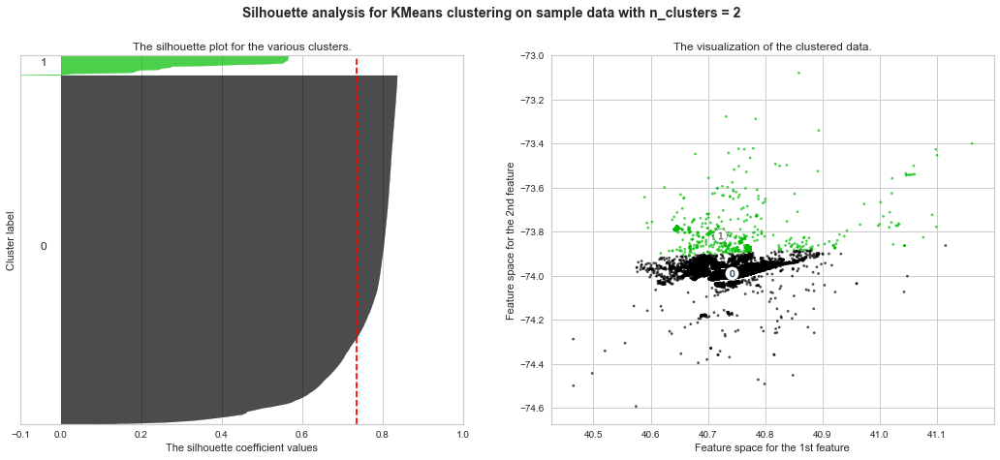

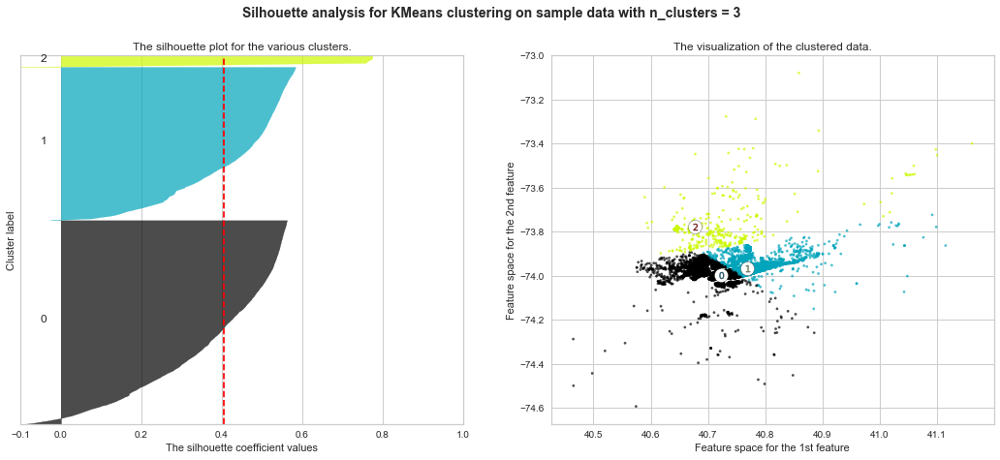

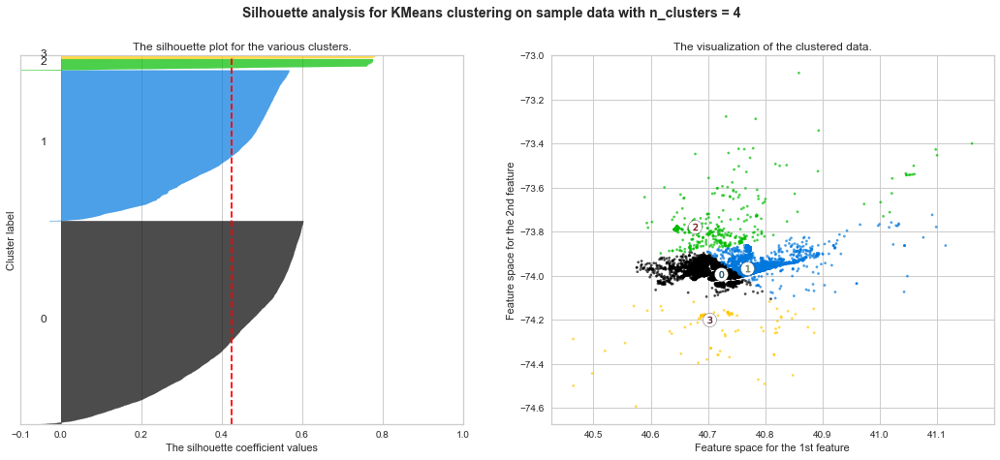

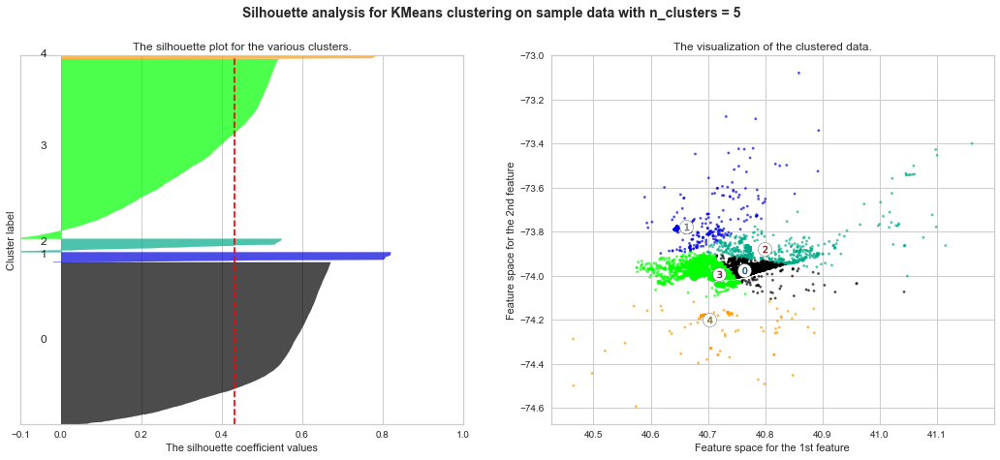

In [21]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np


range_n_clusters = [2,3, 4, 5]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

In [22]:
# silhouette_score(dataset2_geo, kmeans.labels_, metric='euclidean')

  ##### Avec la méthode de la silhoutte  On observe  que le nombre de cluster optimium est de 3 aussi

### le model   : MiniBatchKMeans

In [23]:
from sklearn.cluster import MiniBatchKMeans
kmeans = MiniBatchKMeans(n_clusters=3)
kmeans.fit(dataset2_geo)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=3, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [24]:
y_kmeans = kmeans.predict(dataset2_geo)

In [25]:
cluster = kmeans.cluster_centers_
cluster

array([[ 40.76869153, -73.96306001],
       [ 40.67206696, -73.78248609],
       [ 40.72354006, -73.99550239]])

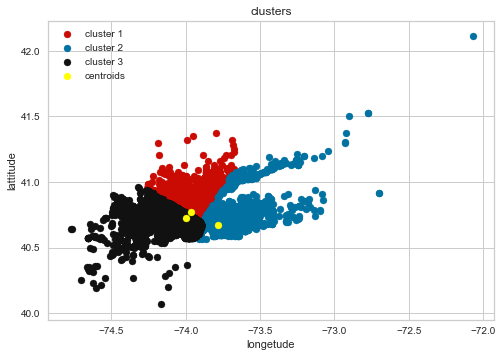

In [26]:
plt.scatter(dataset2_geo["Lon"][y_kmeans == 0],dataset2_geo["Lat"][y_kmeans == 0],c = 'r',label = 'cluster 1')
plt.scatter(dataset2_geo["Lon"][y_kmeans == 1],dataset2_geo["Lat"][y_kmeans == 1],c='b',label = 'cluster 2')
plt.scatter(dataset2_geo["Lon"][y_kmeans == 2],dataset2_geo["Lat"][y_kmeans == 2],c="k",label = 'cluster 3')

# plt.scatter(kmeans.cluster_centers_[], kmeans.cluster_centers_[1],kmeans.cluster_centers_[2], marker="*",label = 'centroids')
plt.scatter(kmeans.cluster_centers_[:,1], kmeans.cluster_centers_[:,0] ,c = 'yellow', label = 'centroids')

plt.title('clusters')
plt.xlabel('longetude')
plt.ylabel('lattitude')
plt.legend()
plt.show()

## VISUALISER LES CLUSTERS SUR UNE CARTE

In [27]:
# !pip install folium

In [28]:
import folium
from folium import plugins
carte1 = folium.Map(location=[40.779897, -73.968565],
               zoom_start=11)

plugins.Fullscreen().add_to(carte1)
plugins.ScrollZoomToggler().add_to(carte1)

In [45]:

folium.Marker(location=cluster[0], popup=cluster[0], icon=folium.Icon(color='green')).add_to(carte1)
folium.Marker(location=cluster[1], popup=cluster[1], icon=folium.Icon(icon='car', prefix='ub', color='green')).add_to(carte1)
folium.Marker(location=cluster[2], popup=cluster[2], icon=folium.Icon(color='green')).add_to(carte1)

In [46]:
carte1

# 2 centres de clusters se trouvent à Manhattan
# 1 centre de cluster se trouve d près de l'aéroport J.F. Kennedy


In [31]:
X = pd.DataFrame(X,columns=dataset2_geo.columns)
kmeans.fit(X)
y_kmeans_X = kmeans.predict(X)

In [32]:
X= X.assign(cluster = y_kmeans_X)

In [33]:
X.apply(lambda row: folium.Circle(radius=1, location=[row['Lat'], row['Lon']], color='orange').add_to(carte1) if row['cluster']==0
                else folium.Circle(radius=1, location=[row['Lat'], row['Lon']], color='red').add_to(carte1) if row['cluster']==1
                else folium.Circle(radius=1, location=[row['Lat'], row['Lon']], color='green').add_to(carte1) , axis=1)

0        <folium.vector_layers.Circle object at 0x00000...
1        <folium.vector_layers.Circle object at 0x00000...
2        <folium.vector_layers.Circle object at 0x00000...
3        <folium.vector_layers.Circle object at 0x00000...
4        <folium.vector_layers.Circle object at 0x00000...
                               ...                        
29995    <folium.vector_layers.Circle object at 0x00000...
29996    <folium.vector_layers.Circle object at 0x00000...
29997    <folium.vector_layers.Circle object at 0x00000...
29998    <folium.vector_layers.Circle object at 0x00000...
29999    <folium.vector_layers.Circle object at 0x00000...
Length: 30000, dtype: object

In [34]:
carte1

In [35]:
carte1.save('clusters.html')

### le model   : DBSCAN

In [36]:
from sklearn.cluster import DBSCAN

In [37]:
from sklearn.model_selection import ParameterGrid

param = {"eps": [0.07,0.5,1,5],
        "min_samples":[50,100,500,1000,5000]}
param_grid = ParameterGrid(param)
list(param_grid)

[{'eps': 0.07, 'min_samples': 50},
 {'eps': 0.07, 'min_samples': 100},
 {'eps': 0.07, 'min_samples': 500},
 {'eps': 0.07, 'min_samples': 1000},
 {'eps': 0.07, 'min_samples': 5000},
 {'eps': 0.5, 'min_samples': 50},
 {'eps': 0.5, 'min_samples': 100},
 {'eps': 0.5, 'min_samples': 500},
 {'eps': 0.5, 'min_samples': 1000},
 {'eps': 0.5, 'min_samples': 5000},
 {'eps': 1, 'min_samples': 50},
 {'eps': 1, 'min_samples': 100},
 {'eps': 1, 'min_samples': 500},
 {'eps': 1, 'min_samples': 1000},
 {'eps': 1, 'min_samples': 5000},
 {'eps': 5, 'min_samples': 50},
 {'eps': 5, 'min_samples': 100},
 {'eps': 5, 'min_samples': 500},
 {'eps': 5, 'min_samples': 1000},
 {'eps': 5, 'min_samples': 5000}]

In [38]:
X= dataset2_geo.sample(100000).values

In [39]:
X

array([[ 40.7325, -74.01  ],
       [ 40.7131, -73.9522],
       [ 40.7212, -74.0506],
       ...,
       [ 40.7275, -73.9884],
       [ 40.751 , -73.9746],
       [ 40.7748, -73.961 ]])

In [40]:
from sklearn.cluster import DBSCAN
clusters = DBSCAN()
# clusters.fit(X)

In [41]:
model_dbscan = DBSCAN(metric='haversine')

best_score = -1

In [42]:
# from sklearn import metrics
# from sklearn.metrics import silhouette_score
# for g in param_grid:
#     model_dbscan.set_params(**g)
#     model_dbscan.fit(X)

#     ss = metrics.silhouette_score(X, model_dbscan.labels_)
#     print('Parameter: ', g, 'Score: ', ss)
#     if ss > best_score:
#         best_score = ss
#         best_grid = g


In [43]:
# model_dbscan.set_params(**best_grid)
# model_dbscan.fit(X)

In [44]:
# np.unique(model_dbscan.labels_)